### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [5]:
fig_dir = '../v2-fig/fig-cgis/'

In [6]:
cgi_csv = '../data/v2/institutions_data_prepped.csv'

In [7]:
cgi_df = pd.read_csv(cgi_csv)

In [8]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_po

Note: CGI -> CGI *mechanisms*

In [9]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [10]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_po

In [11]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['access_cgis_include_age_boundaries',
 'enforcement_cgis_include_criticism_mocking_joking',
 'enforcement_cgis_include_reputational_risk',
 'decision_making_cgis_include_assembly_elite',
 'enforcement_cgis_include_litigation',
 'decision_making_cgis_include_unanimity',
 'access_cgis_include_meritocracy',
 'enforcement_cgis_include_appeal',
 'decision_making_cgis_include_consultation',
 'decision_making_cgis_include_ratification_acclamation_only',
 'enforcement_cgis_include_exit',
 'decision_making_cgis_include_secret_ballot',
 'decision_making_cgis_include_turnover_rotation',
 'decision_making_cgis_include_supermajority',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_assembly_central',
 'enforcement_cgis_include_scrutiny_of_officials',
 'decision_making_cgis_include_council_central_',
 'enforcement_cgis_include_jury_judge',
 'decision_making_cgis_include_vote_by_proxy',
 'access_cgis_include_screening_process',
 'access_cgis_include_matriarchy',
 'deci

In [12]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [13]:
cgi_mechanisms_df

,access_cgis_include_age_boundaries,enforcement_cgis_include_criticism_mocking_joking,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_assembly_elite,enforcement_cgis_include_litigation,decision_making_cgis_include_unanimity,access_cgis_include_meritocracy,enforcement_cgis_include_appeal,decision_making_cgis_include_consultation,decision_making_cgis_include_ratification_acclamation_only,enforcement_cgis_include_exit,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_turnover_rotation,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_local,decision_making_cgis_include_assembly_central,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_council_central_,enforcement_cgis_include_jury_judge,decision_making_cgis_include_vote_by_proxy,access_cgis_include_screening_process,access_cgis_include_matriarchy,decision_making_cgis_include_magistrate_official,enforcement_cgis_include_arbitration,access_cgis_include_lottery_random_selection,decision_making_cgis_include_public_meetings,decision_making_cgis_include_council_local,decision_making_cgis_include_veto,decision_making_cgis_include_deliberation,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_majority_voting,decision_making_cgis_include_vote_by_show_of_hands,decision_making_cgis_include_consensus,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_quorum,decision_making_cgis_include_gathering,enforcement_cgis_include_tribunal_court_,access_cgis_include_gerontocracy,decision_making_cgis_include_oath,access_cgis_include_election,access_cgis_include_popularity_,access_cgis_include_female_participation,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_consent,access_cgis_include_matrilineality,decision_making_cgis_include_representation,access_cgis_include_heredity,access_cgis_include_patronage_for_office,access_cgis_include_blood_relations,access_cgis_include_co-optation,decision_making_cgis_include_board_committee,decision_making_cgis_include_frequent_and_or_regular_meetings,access_cgis_include_property_requirement,access_cgis_include_payment_for_occupying_office,access_cgis_include_life_appointment,decision_making_cgis_include_remunerated_position,enforcement_cgis_include_judicial_review,decision_making_cgis_include_group_voting
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
23,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
25,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
29,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,1,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0
30,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [14]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                           41
decision_making_cgis_include_assembly_central                           27
decision_making_cgis_include_council_local                              26
enforcement_cgis_include_tribunal_court_                                22
decision_making_cgis_include_frequent_and_or_regular_meetings           19
access_cgis_include_election                                            18
decision_making_cgis_include_deliberation                               17
decision_making_cgis_include_consensus                                  15
decision_making_cgis_include_representation                             15
decision_making_cgis_include_assembly_local                             14
access_cgis_include_female_participation                                12
access_cgis_include_age_boundaries                                      10
access_cgis_include_gerontocracy                                        10
decision_making_cgis_incl

In [18]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [19]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [20]:
cgi_df[access_cgis]

,access_cgis_include_age_boundaries,access_cgis_include_meritocracy,access_cgis_include_screening_process,access_cgis_include_matriarchy,access_cgis_include_lottery_random_selection,access_cgis_include_gerontocracy,access_cgis_include_election,access_cgis_include_popularity_,access_cgis_include_female_participation,access_cgis_include_matrilineality,access_cgis_include_heredity,access_cgis_include_patronage_for_office,access_cgis_include_blood_relations,access_cgis_include_co-optation,access_cgis_include_property_requirement,access_cgis_include_payment_for_occupying_office,access_cgis_include_life_appointment
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

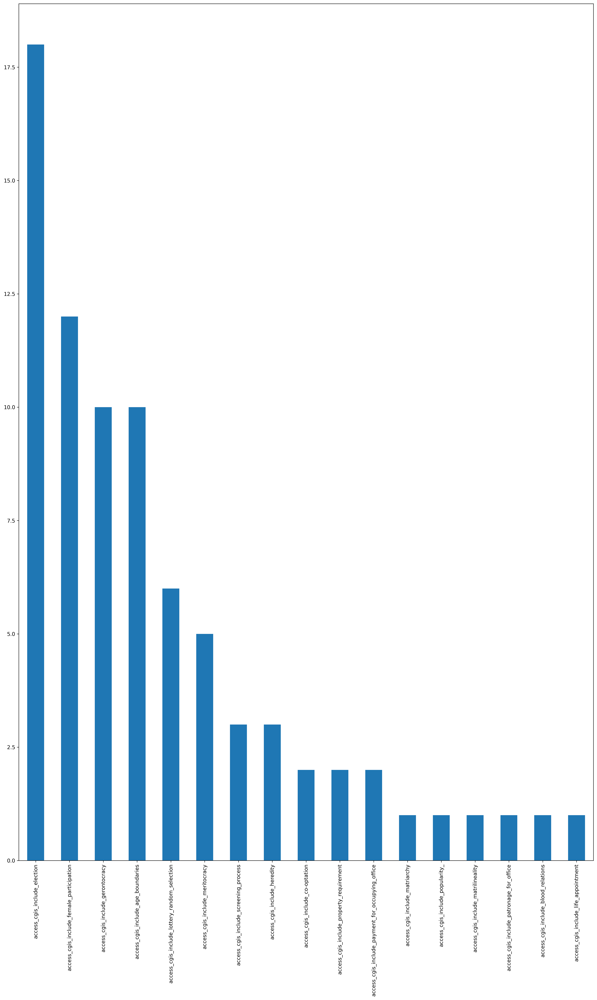

In [21]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

In [22]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

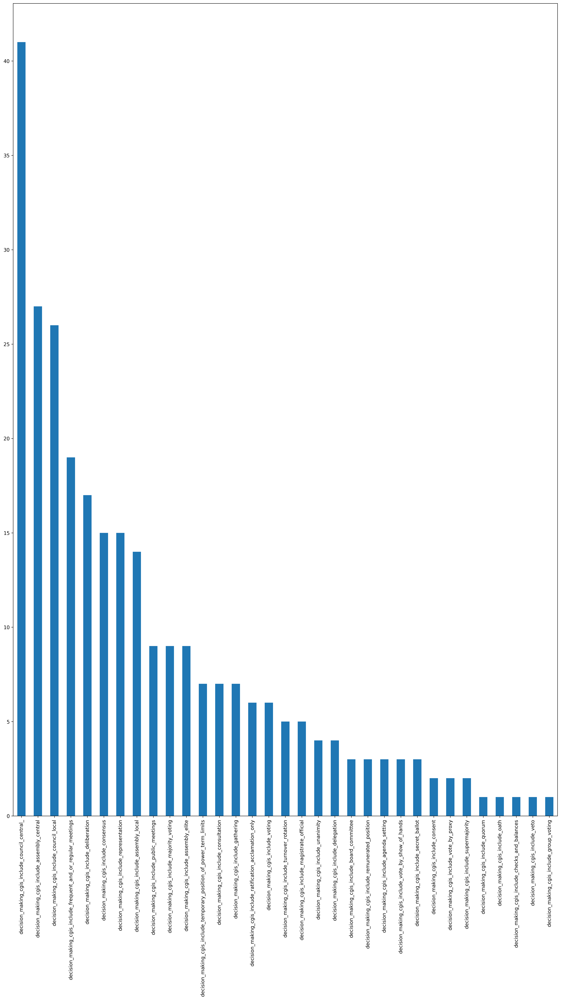

In [23]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

In [24]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

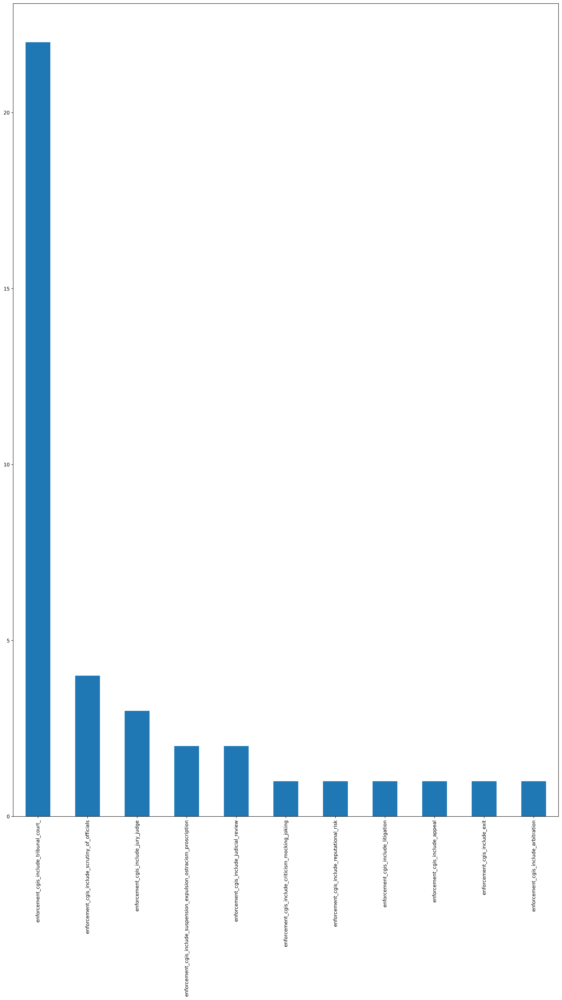

In [25]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

# CGI Mechanism Analysis 

In [26]:
# Select columns of interest

In [27]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',
 'decision_making_mechanisms_inc

In [28]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [29]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [30]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',
 'decision_making_mechanisms_inc

## Normalized Correlation Matrix

In [31]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [32]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [33]:
data_plot.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [34]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [35]:
norm_corr.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

# Visualize and Sort CGI Correlations

In [36]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_54676/4008594290.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [ ]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

In [ ]:
cgis_df = norm_corr[cgis_list]

In [39]:
cgis_df

,access_cgis_include_age_boundaries,enforcement_cgis_include_criticism_mocking_joking,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_assembly_elite,enforcement_cgis_include_litigation,decision_making_cgis_include_unanimity,access_cgis_include_meritocracy,enforcement_cgis_include_appeal,decision_making_cgis_include_consultation,decision_making_cgis_include_ratification_acclamation_only,enforcement_cgis_include_exit,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_turnover_rotation,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_local,decision_making_cgis_include_assembly_central,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_council_central_,enforcement_cgis_include_jury_judge,decision_making_cgis_include_vote_by_proxy,access_cgis_include_screening_process,access_cgis_include_matriarchy,decision_making_cgis_include_magistrate_official,enforcement_cgis_include_arbitration,access_cgis_include_lottery_random_selection,decision_making_cgis_include_public_meetings,decision_making_cgis_include_council_local,decision_making_cgis_include_veto,decision_making_cgis_include_deliberation,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_delegation,decision_making_cgis_include_voting,decision_making_cgis_include_majority_voting,decision_making_cgis_include_vote_by_show_of_hands,decision_making_cgis_include_consensus,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_quorum,decision_making_cgis_include_gathering,enforcement_cgis_include_tribunal_court_,access_cgis_include_gerontocracy,decision_making_cgis_include_oath,access_cgis_include_election,access_cgis_include_popularity_,access_cgis_include_female_participation,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_consent,access_cgis_include_matrilineality,decision_making_cgis_include_representation,access_cgis_include_heredity,access_cgis_include_patronage_for_office,access_cgis_include_blood_relations,access_cgis_include_co-optation,decision_making_cgis_include_board_committee,decision_making_cgis_include_frequent_and_or_regular_meetings,access_cgis_include_property_requirement,access_cgis_include_payment_for_occupying_office,access_cgis_include_life_appointment,decision_making_cgis_include_remunerated_position,enforcement_cgis_include_judicial_review,decision_making_cgis_include_group_voting
Time span: Start,-0.245590,0.046421,0.028739,-0.003251,-0.085292,0.036643,0.086466,0.036999,-0.030520,-0.093885,0.037703,-0.106827,-0.157352,0.052780,0.009678,-0.199434,-0.164419,-0.165339,-0.143841,0.060411,-0.140105,-0.085811,-0.122923,0.046129,-0.177711,-0.096562,0.154643,0.046067,-0.041299,-0.107689,-0.089204,-0.075473,-0.113274,-0.106828,-0.015611,-0.072133,-0.144441,-0.078220,0.064076,-0.059506,0.035612,-0.085292,-0.132800,0.044438,0.082725,0.027200,0.025313,0.028739,0.023133,0.067121,0.044203,0.028191,0.059636,-0.103374,-0.049909,-0.110798,0.037304,0.041815,-0.144199,-0.074094,-0.078122
Time span: End,-0.209552,0.033592,0.042183,0.019111,-0.090416,0.031814,0.083920,0.039821,-0.004362,-0.043760,0.039512,-0.088752,-0.129190,0.054473,0.002479,-0.121856,-0.135394,-0.107467,-0.142423,0.051360,-0.103309,-0.086673,-0.087978,0.033871,-0.153723,-0.068177,0.132850,0.033929,-0.015494,-0.085096,-0.040198,-0.055970,-0.105771,-0.088753,-0.002619,-0.080119,-0.136559,-0.043237,0.082521,-0.038821,0.013436,-0.090416,-0.083546,0.035350,0.074193,0.042402,0.050867,0.042183,0.023956,0.064863,0.035539,0.042268,0.051830,-0.082397,-0.047916,-0.061244,0.059672,0.037259,-0.130614,-0.075594,-0.042990
enforcement_mechanisms_include_seizing_of_property,0.725419,-0.008792,-0.008792,-0.024935,0.428938,-0.017457,-0.019601,-0.008792,-0.020873,-0.016004,-0.008792,0.299613,0.427763,-0.012187,-0.031061,0.080942,0.432597,0.198235,-0.015120,-0.012430,0.24637

In [40]:
query_cgis_df = cgis_df.transpose()

In [41]:
query_cgis_df.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

## Time x Region x Size for CGIs

In [42]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [43]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [44]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [45]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',
 'decision_making_mechanisms_inc

## Time x CGIs

In [46]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_age_boundaries,-0.245590,-0.209552,0.185406
enforcement_cgis_include_criticism_mocking_joking,0.046421,0.033592,-0.051037
enforcement_cgis_include_reputational_risk,0.028739,0.042183,0.025242
decision_making_cgis_include_assembly_elite,-0.003251,0.019111,0.060620
enforcement_cgis_include_litigation,-0.085292,-0.090416,0.017510
decision_making_cgis_include_unanimity,0.036643,0.031814,-0.026209
access_cgis_include_meritocracy,0.086466,0.083920,-0.038322
enforcement_cgis_include_appeal,0.036999,0.039821,-0.006003
decision_making_cgis_include_consultation,-0.030520,-0.004362,0.080658
decision_making_cgis_include_ratification_acclamation_only,-0.093885,-0.043760,0.167483


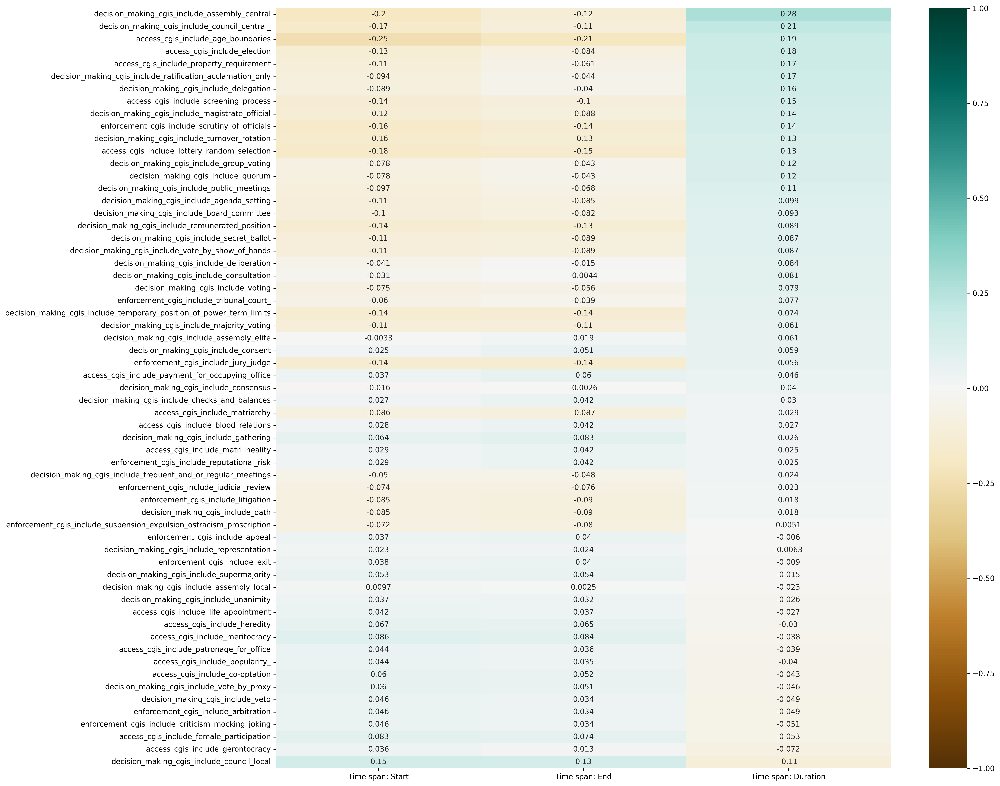

In [56]:
plt.figure(figsize=(20,15))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [57]:
access_cgis

['access_cgis_include_age_boundaries',
 'access_cgis_include_meritocracy',
 'access_cgis_include_screening_process',
 'access_cgis_include_matriarchy',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_election',
 'access_cgis_include_popularity_',
 'access_cgis_include_female_participation',
 'access_cgis_include_matrilineality',
 'access_cgis_include_heredity',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_blood_relations',
 'access_cgis_include_co-optation',
 'access_cgis_include_property_requirement',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_life_appointment']

In [58]:
time_access_cgis = time_cgis.loc[access_cgis]

In [59]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_age_boundaries,-0.245590,-0.209552,0.185406
access_cgis_include_meritocracy,0.086466,0.083920,-0.038322
access_cgis_include_screening_process,-0.140105,-0.103309,0.148925
access_cgis_include_matriarchy,-0.085811,-0.086673,0.029026
access_cgis_include_lottery_random_selection,-0.177711,-0.153723,0.128608
access_cgis_include_gerontocracy,0.035612,0.013436,-0.071936
access_cgis_include_election,-0.132800,-0.083546,0.179370
access_cgis_include_popularity_,0.044438,0.035350,-0.040371
access_cgis_include_female_participation,0.082725,0.074193,-0.052866
access_cgis_include_matrilineality,0.028739,0.042183,0.025242


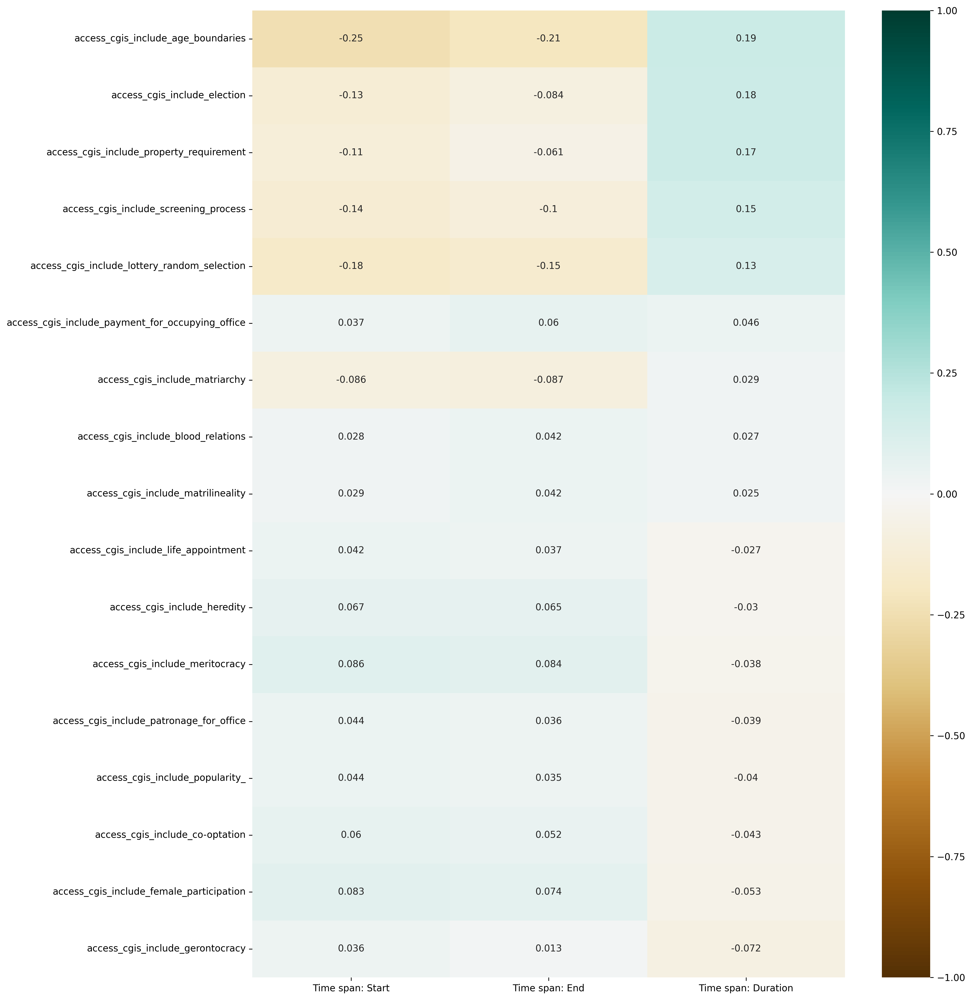

In [60]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [61]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

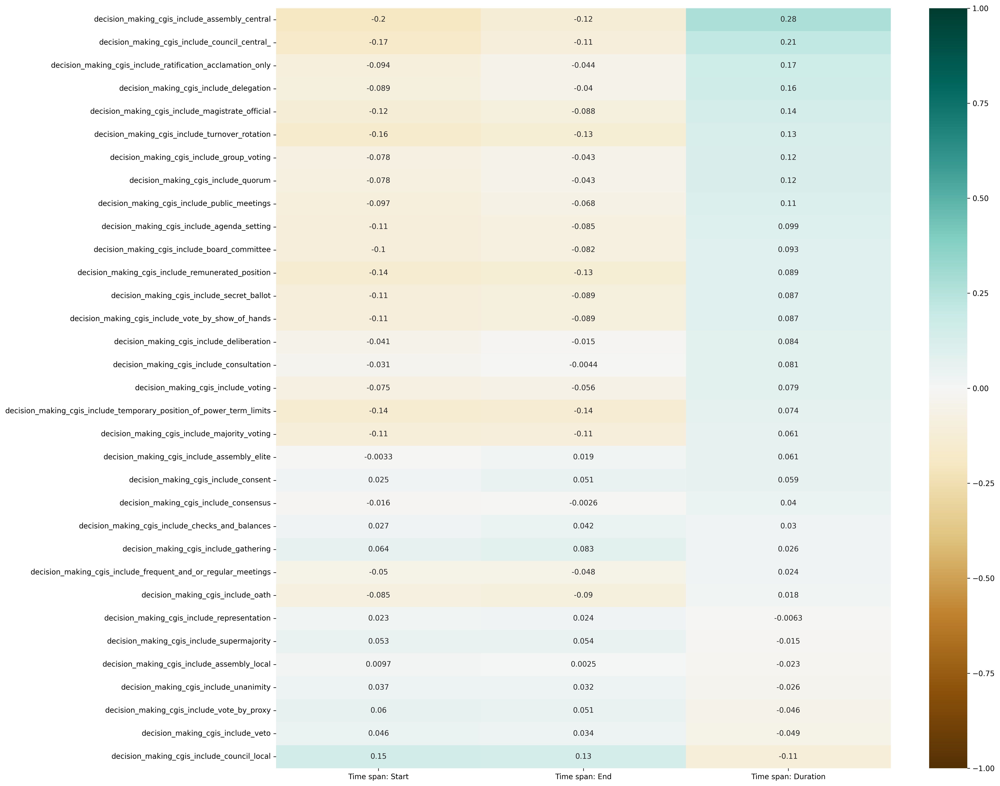

In [62]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [63]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

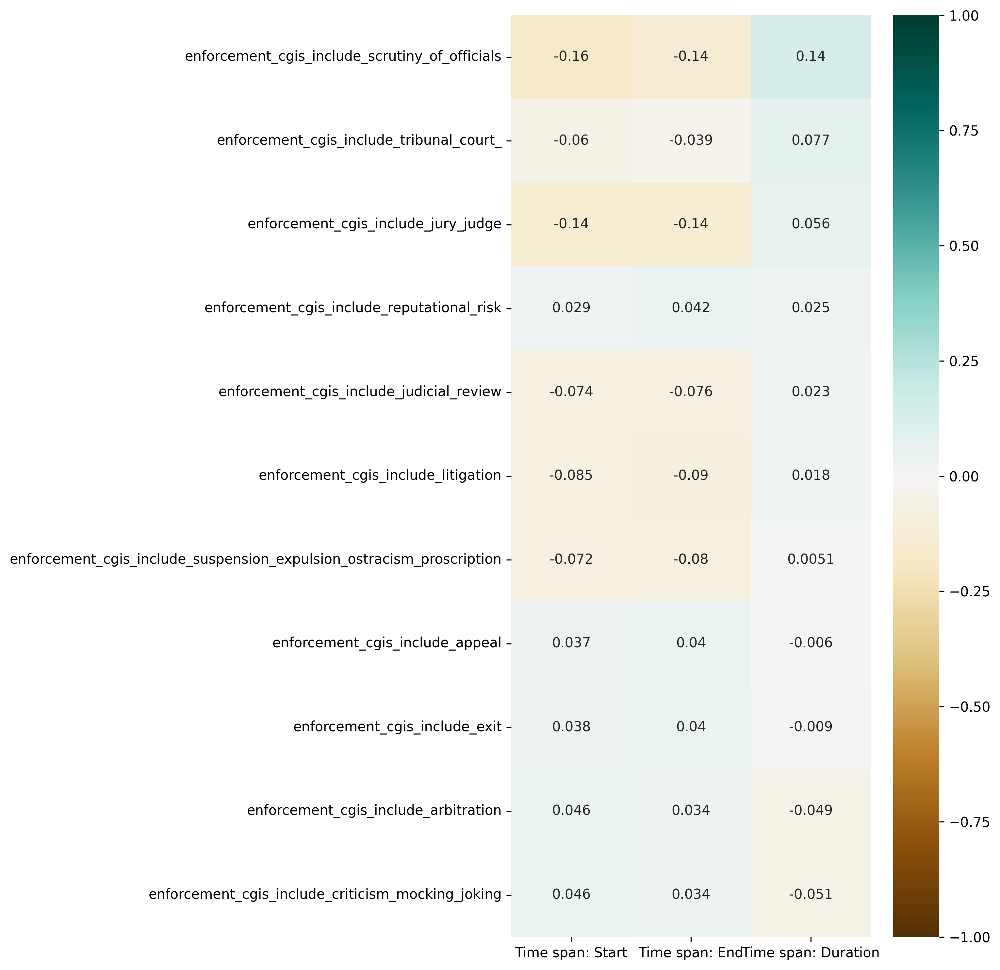

In [64]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [65]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_cgis_include_age_boundaries,-0.050152,0.405920,-0.083213,-0.061884,-0.068422,-0.034305,-0.013982,-0.017151
enforcement_cgis_include_criticism_mocking_joking,-0.017979,-0.028400,0.075463,-0.019903,-0.022005,-0.011033,-0.004497,-0.005516
enforcement_cgis_include_reputational_risk,0.091424,-0.028400,-0.026762,-0.019903,-0.022005,-0.011033,-0.004497,-0.005516
decision_making_cgis_include_assembly_elite,0.001034,-0.027413,0.169140,-0.056443,-0.062407,-0.031289,-0.012753,0.112933
enforcement_cgis_include_litigation,-0.017979,0.138039,-0.026762,-0.019903,-0.022005,-0.011033,-0.004497,-0.005516
decision_making_cgis_include_unanimity,-0.012894,-0.030897,-0.053135,-0.039516,0.060580,-0.021905,-0.008928,0.268567
access_cgis_include_meritocracy,0.014921,-0.063313,-0.059662,-0.044369,0.094715,0.220432,-0.010025,-0.012297
enforcement_cgis_include_appeal,-0.017979,0.036995,-0.026762,-0.019903,-0.022005,-0.011033,-0.004497,-0.005516
decision_making_cgis_include_consultation,-0.042681,-0.067421,0.105847,0.176770,0.106749,-0.026192,-0.010675,-0.013095
decision_making_cgis_include_ratification_acclamation_only,-0.032726,0.355763,-0.023504,-0.022911,-0.040055,-0.020083,-0.008185,-0.010041


In [66]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

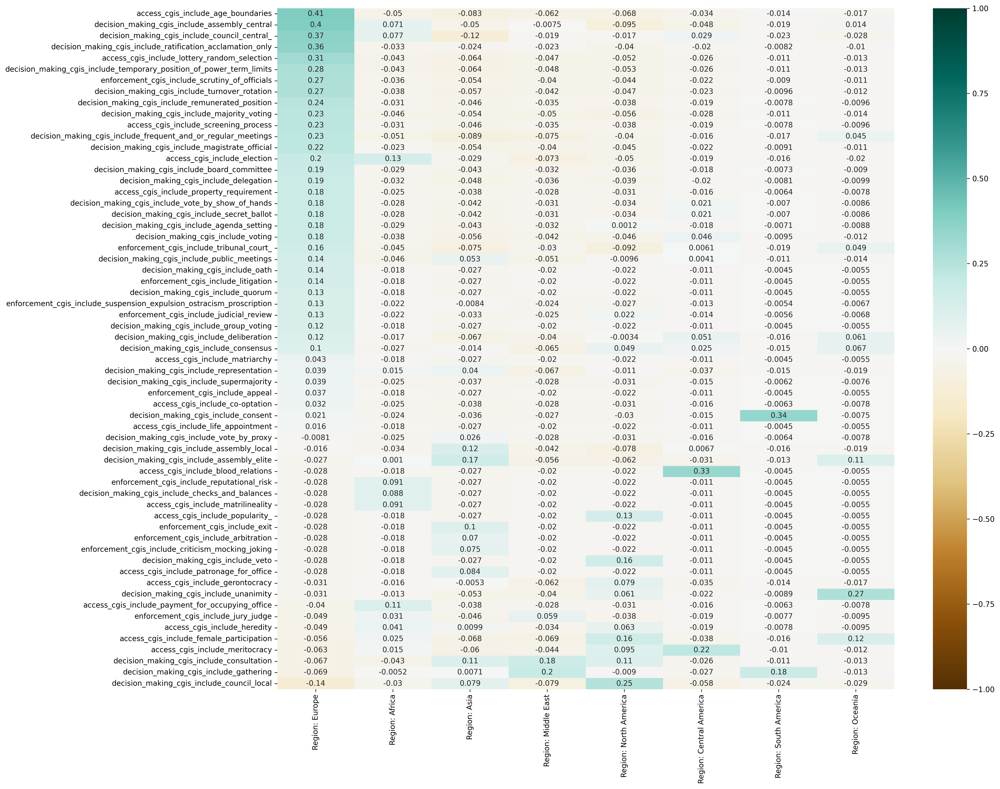

In [67]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [68]:
region_access_cgis = region_cgis.loc[access_cgis]

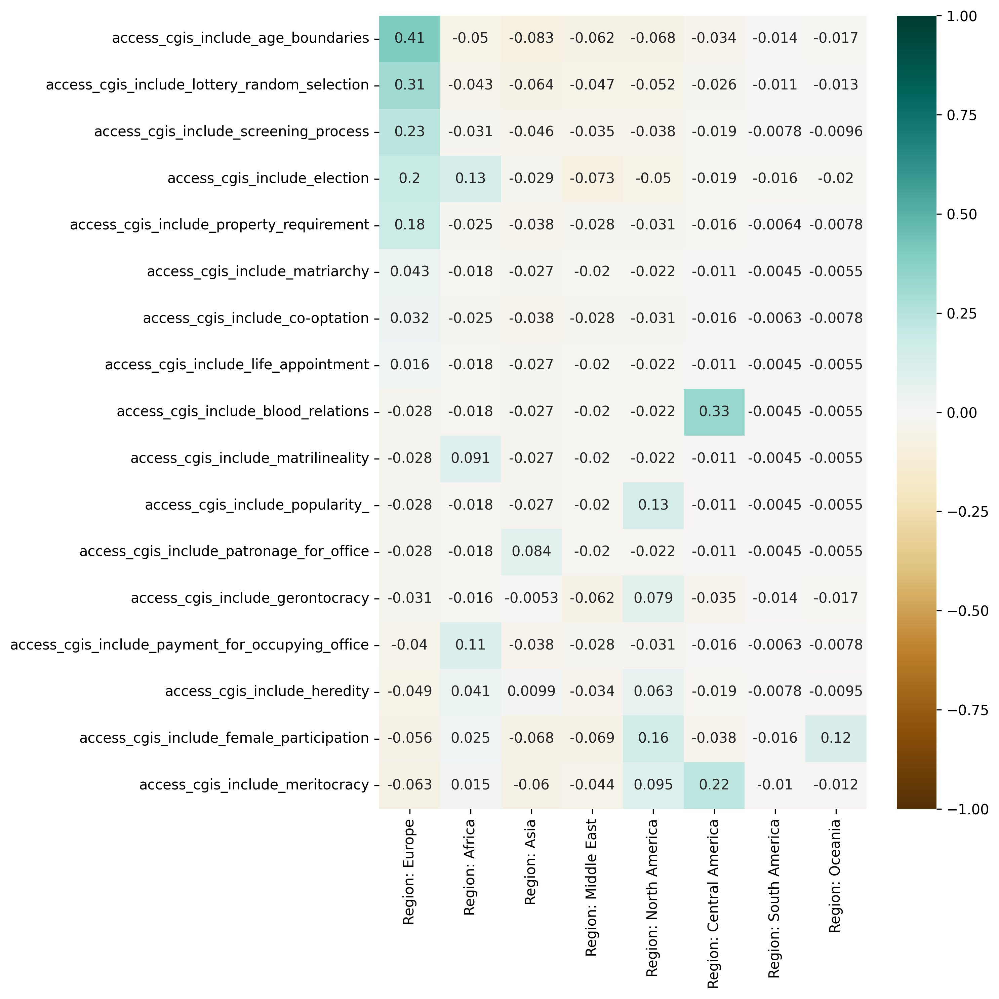

In [89]:
plt.figure(figsize=(10,10))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [70]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

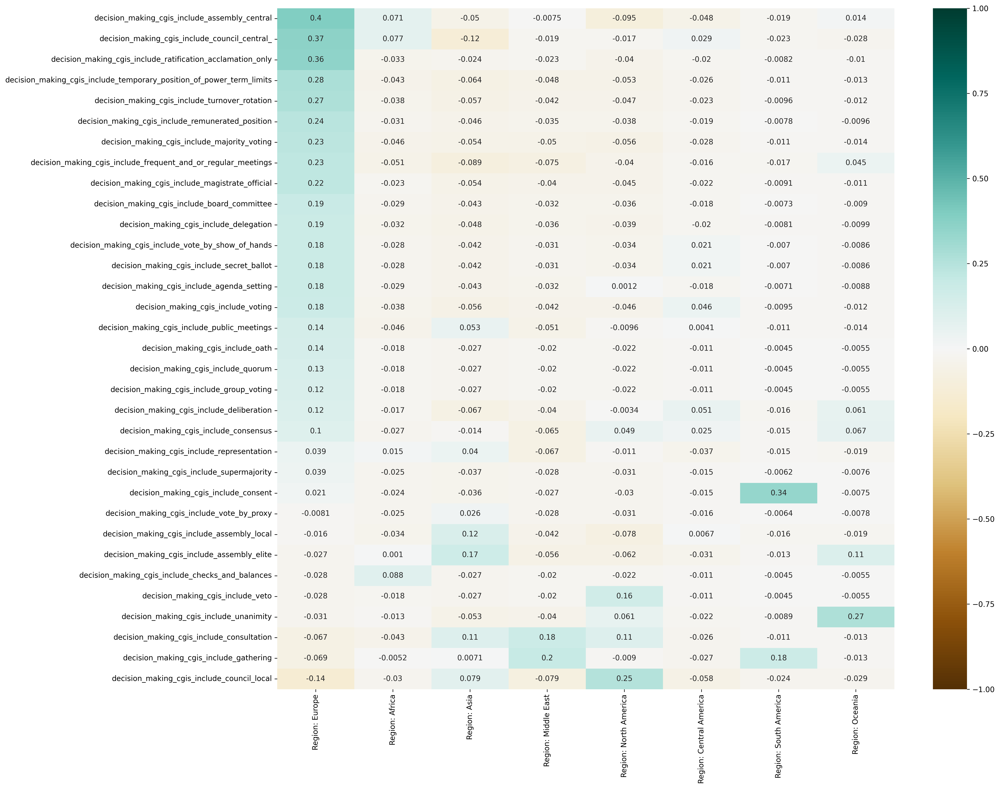

In [71]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [72]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

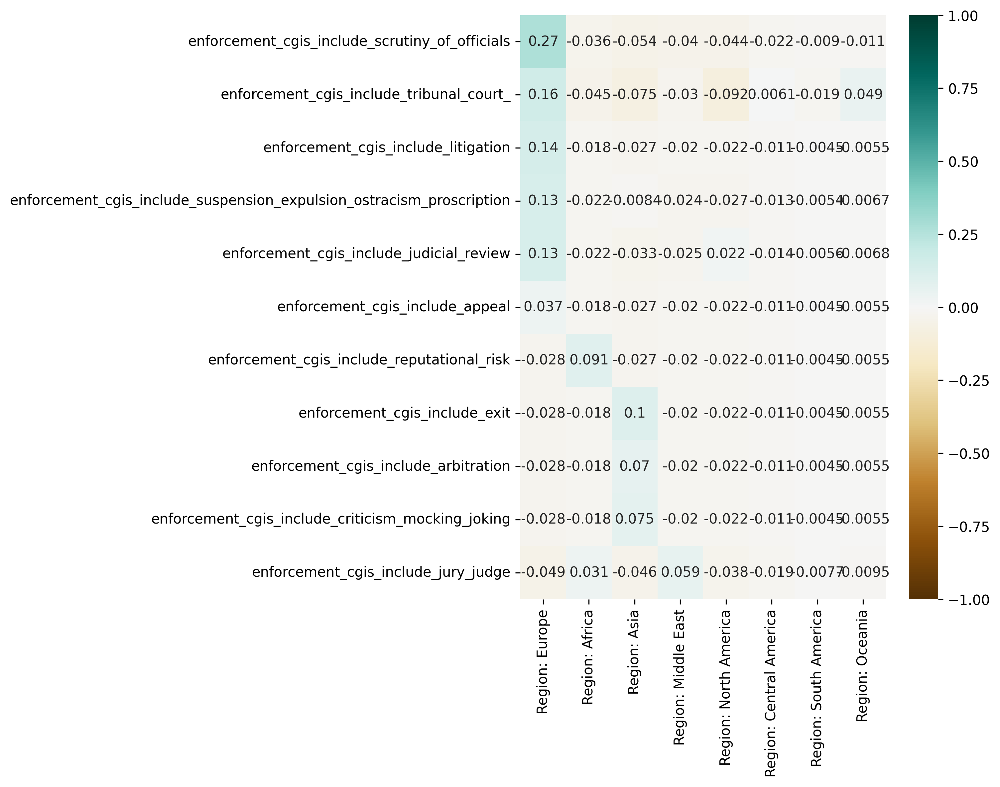

In [88]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [74]:
size_cgis = query_cgis_df[size_cols]

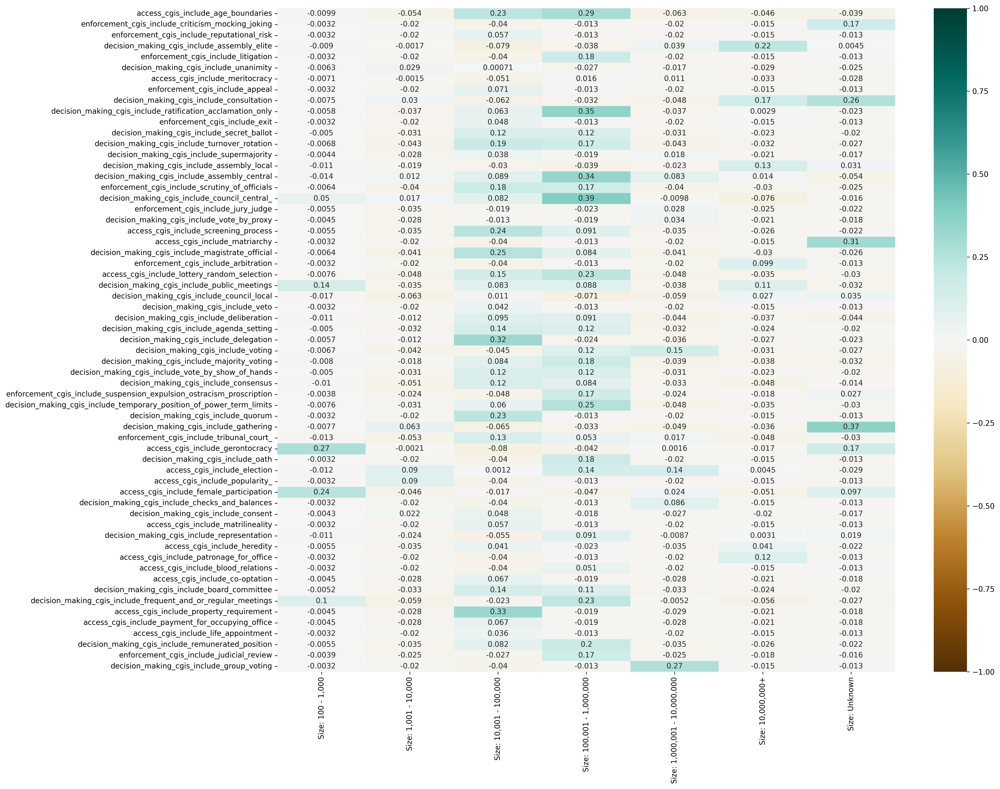

In [75]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [76]:
size_access_cgis = size_cgis.loc[access_cgis]

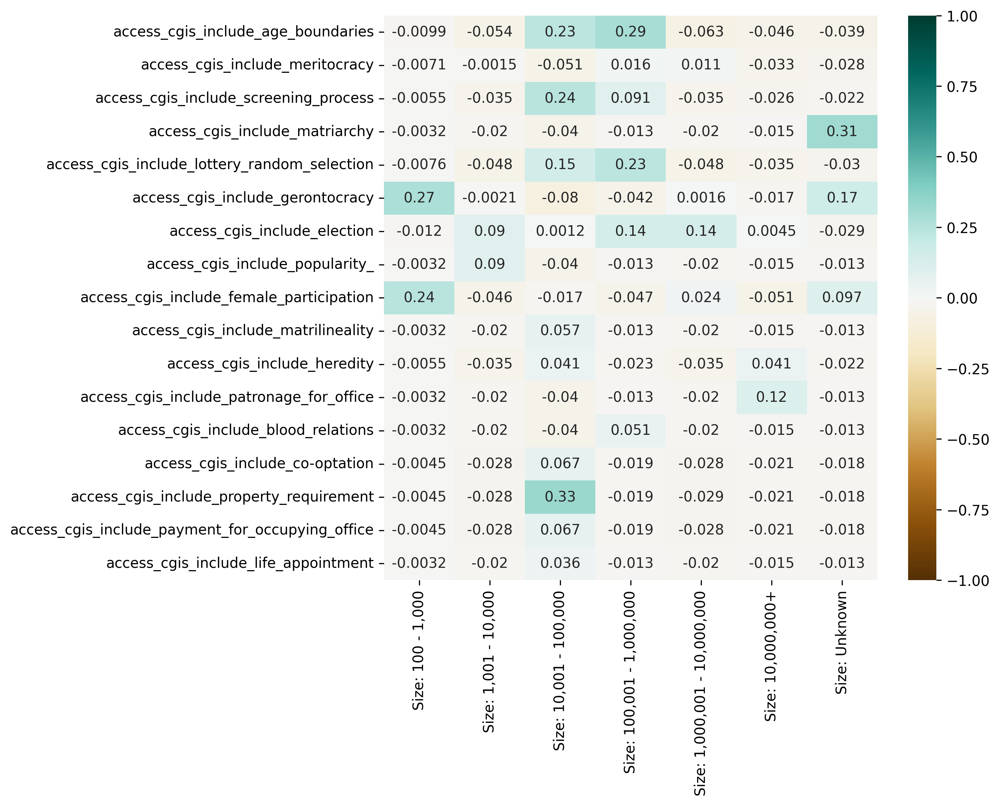

In [77]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [78]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

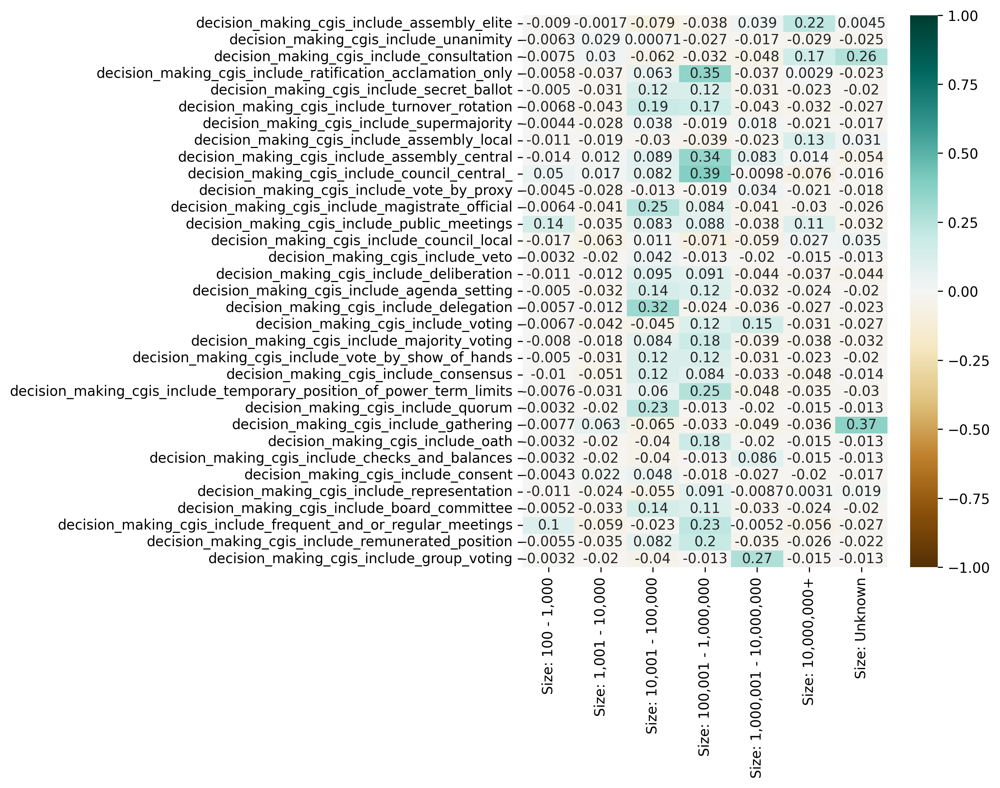

In [79]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [80]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

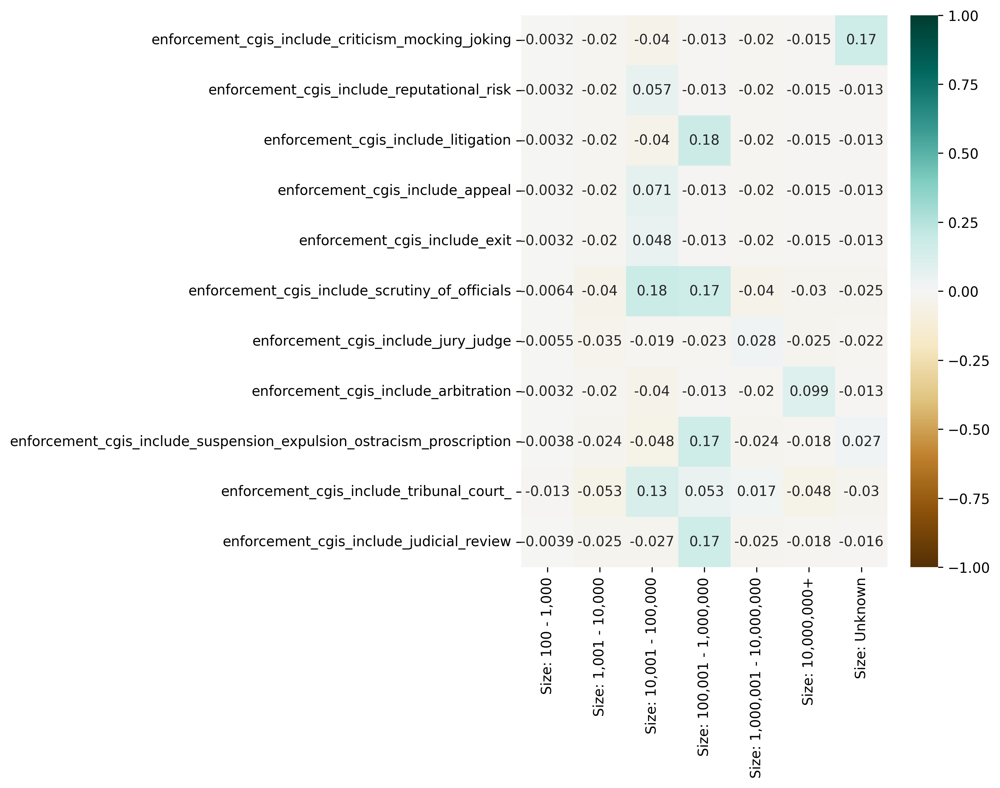

In [81]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [82]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [83]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [84]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_secret_ballot    decision_making_mechanisms_include_vote_by_show_of_hands    1.000000
enforcement_mechanisms_include_seizing_of_property  decision_making_mechanisms_include_plurality_voting         1.000000
decision_making_mechanisms_include_power_fluidity   Region: South America                                       1.000000
enforcement_mechanisms_include_graduated_sanctions  Size: 100 - 1,000                                           1.000000
decision_making_mechanisms_include_mandate          Geography: Middle East, Mesopotamia, Babylonia              1.000000
                                                                                                                  ...   
Time span: Start                                    Time span: Duration                                        -0.508333
Time span: End                                      Geography: Middle East                                     -0.510783
Time span: Start                

In [85]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/v2/cgis_all_correlations.csv')

In [86]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: End                                     Region: Middle East                                      -0.536479
Time span: Start                                   decision_making_mechanisms_include_assembly_central      -0.524731
                                                   decision_making_mechanisms_include_magistrate_official   -0.512709
Time span: End                                     Geography: Middle East                                   -0.510783
Time span: Start                                   Time span: Duration                                      -0.508333
                                                                                                               ...   
decision_making_mechanisms_include_lobbying        Geography: Africa West, Mid-western Nigeria               1.000000
Geography: South America, Brazil                   Region: South America                                     1.000000
decision_making_mechanisms_include_mandate         Geogr

In [87]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/v2/cgis_negative_correlations.csv')